#**¿POR QUE LOS EMPLEADOS RENUNCIAN?**
### Analisis de Recursos Humanos sobre la deserción de los trabajadores

--------

##**ANALISIS EXPLORATORIO DE DATOS**

--------

In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.0/22.0 MB 20.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 KB 3.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 KB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 64.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 64.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 KB 21.4 MB/s eta 0:00:00
  Created wheel for pandas-profiling: filename=pandas_profiling-0.0.dev0-py2.py3-none-any.whl size=328849 sha256=87ba1824ec510b9604d089943aff7b991ac170f0d284ab4121688218e048067a
  Stored in directory: /tmp/pip-ephem-wheel-cache-fd8uf9b_/wheels/64/b6/85/dfc808b23666a5910371784e349d28818006ff63ed9cfeca59
  Created wheel for htmlmin: file

In [ ]:
#Importar librerías: 
import pandas as pd
import numpy as np

from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split

from tqdm import tqdm

from sklearn.metrics import confusion_matrix

from matplotlib import style

from sklearn import svm

import imblearn
from collections import Counter
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline


In [ ]:
from functools import reduce

In [ ]:
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB

from sklearn.metrics import recall_score, confusion_matrix, classification_report
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer



In [ ]:
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import KFold
from sklearn.metrics import recall_score, confusion_matrix, classification_report
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import accuracy_score


In [ ]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.colors as mcolors
import seaborn as sns
import graphviz
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import pandas_profiling
import plotly.graph_objects as gp
from IPython.display import Image

%matplotlib inline

import warnings
from warnings import filterwarnings
warnings.filterwarnings('ignore')
import os

In [ ]:
#Lectura del dataset
url = 'https://raw.githubusercontent.com/andreamendezortiz/hr_employee.csv/main/hr_employee.csv'
df_hr = pd.read_csv(url)



In [ ]:
#Revisión del dataset
df_hr.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [ ]:
#Tipos de datos
df_hr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

## **Resúmenes numéricos**








**1. Análisis de valores:**

In [ ]:
profile = pandas_profiling.ProfileReport(df_hr)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**2. Heatmap:**

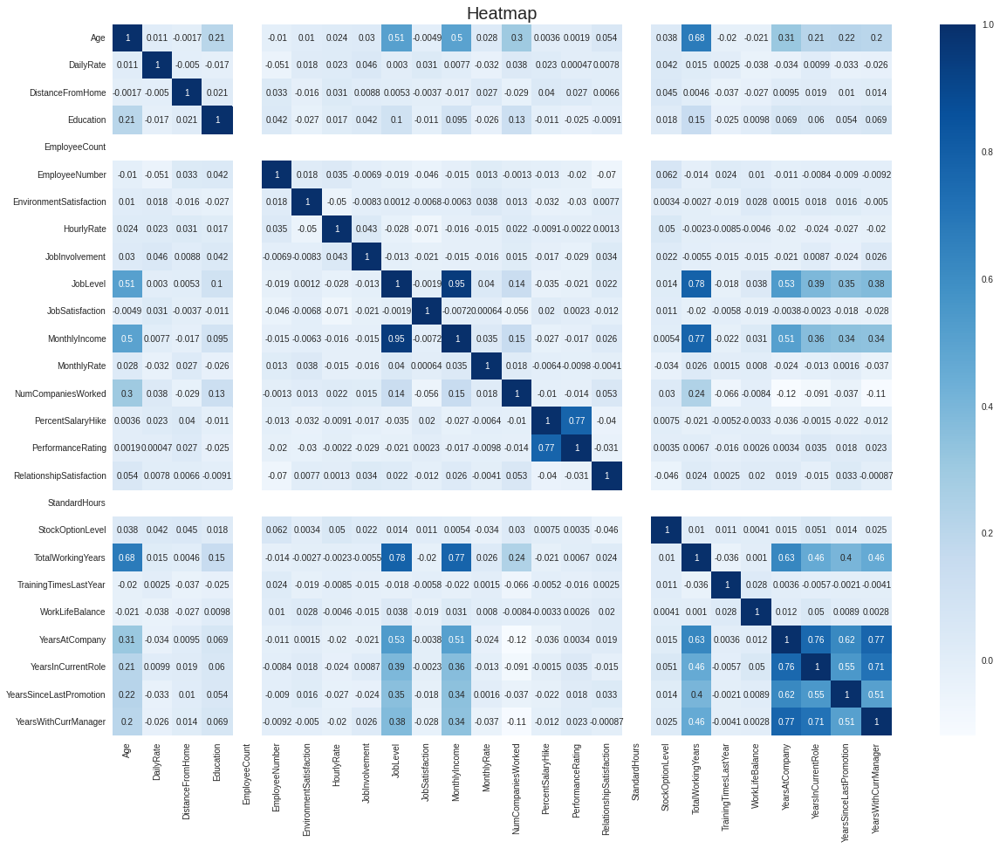

In [ ]:
plt.rcParams['figure.figsize'] = (20, 15)

sns.heatmap(df_hr.corr(), annot = True, cmap = 'Blues')
plt.title('Heatmap', fontsize = 20)
plt.show()

**3. Análisis de valores de correlación:** 

In [ ]:
df_hr.corr()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,0.010661,-0.001686,0.208034,NaN,-0.010145,0.010146,0.024287,0.029820,0.509604,...,0.053535,NaN,0.037510,0.680381,-0.019621,-0.021490,0.311309,0.212901,0.216513,0.202089
DailyRate,0.010661,1.000000,-0.004985,-0.016806,NaN,-0.050990,0.018355,0.023381,0.046135,0.002966,...,0.007846,NaN,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363
DistanceFromHome,-0.001686,-0.004985,1.000000,0.021042,NaN,0.032916,-0.016075,0.031131,0.008783,0.005303,...,0.006557,NaN,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406
Education,0.208034,-0.016806,0.021042,1.000000,NaN,0.042070,-0.027128,0.016775,0.042438,0.101589,...,-0.009118,NaN,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065
EmployeeCount,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EmployeeNumber,-0.010145,-0.050990,0.032916,0.042070,NaN,1.000000,0.017621,0.035179,-0.006888,-0.018519,...,-0.069861,NaN,0.062227,-0.014365,0.023603,0.010309,-0.011240,-0.008416,-0.009019,-0.009197
EnvironmentSatisfaction,0.010146,0.018355,-0.016075,-0.027128,NaN,0.017621,1.000000,-0.049857,-0.008278,0.001212,...,0.007665,NaN,0.003432,-0.002693,-0.019359,0.027627,0.001458,0.018007,0.016194,-0.004999
HourlyRate,0.024287,0.023381,0.031131,0.016775,NaN,0.035179,-0.049857,1.000000,0.042861,-0.027853,...,0.001330,NaN,0.050263,-0.002334,-0.008548,-0.004607,-0.019582,-0.024106,-0.026716,-0.020123
JobInvolvement,0.029820,0.046135,0.008783,0.042438,NaN,-0.006888,-0.008278,0.042861,1.000000,-0.012630,...,0.034297,NaN,0.021523,-0.005533,-0.015338,-0.014617,-0.021355,0.008717,-0.024184,0.025976
JobLevel,0.509604,0.002966,0.005303,0.101589,NaN,-0.018519,0.001212,-0.027853,-0.012630,1.000000,...,0.021642,NaN,0.013984,0.782208,-0.018191,0.037818,0.534739,0.389447,0.353885,0.375281


##**Manejo de datos ausentes y limpieza de datos** 


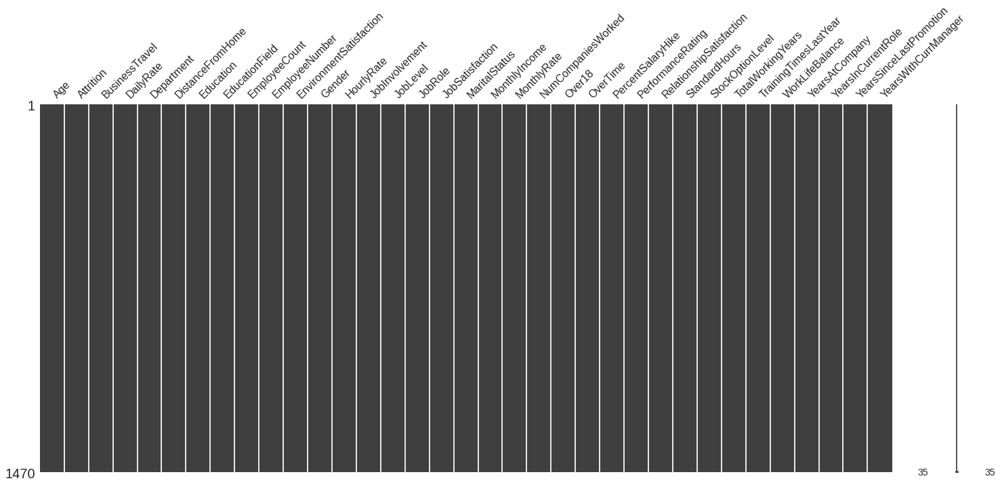

In [ ]:
import missingno as msno
msno.matrix(df_hr)

In [ ]:
#Identificación de valores nulos:
df_hr.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

##**Exploración de variables**

###**Renuncias**

Text(0.5, 1.0, 'Renuncias ')

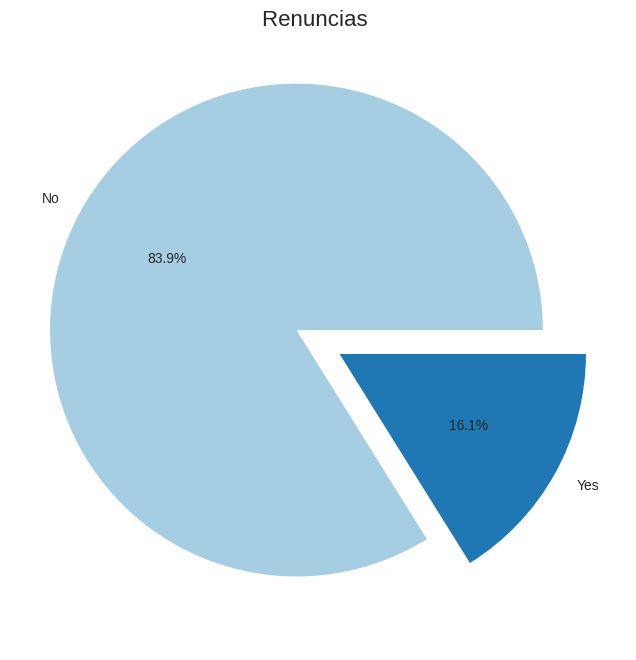

In [ ]:
plt.figure(figsize=(8,8))
pie = df_hr.groupby('Attrition')['Attrition'].count()
sns.set_palette(sns.color_palette("Paired"))
colors = ['#20639B','#3CAEA3']
plt.pie(pie, explode=[0.1, 0.1], labels=['No', 'Yes'], autopct='%1.1f%%');
plt.title('Renuncias ', fontsize = 16)

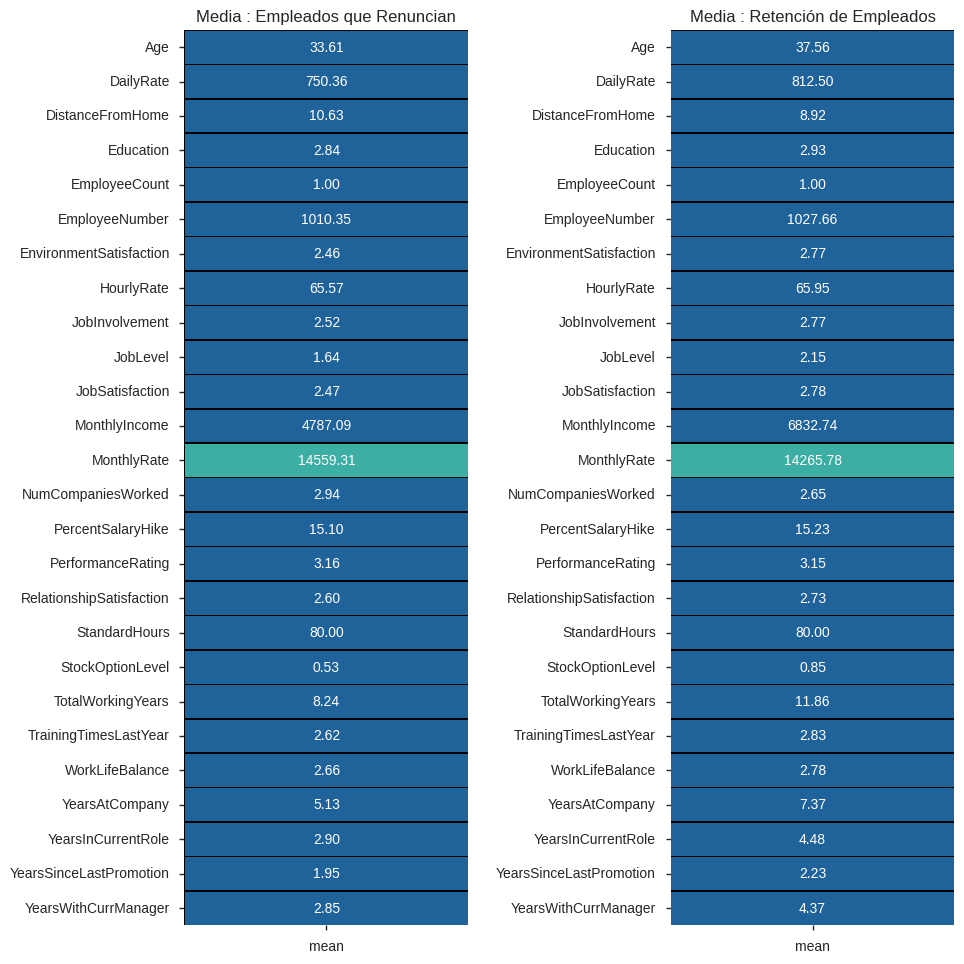

In [ ]:
yes = df_hr[df_hr['Attrition'] == 'Yes'].describe().T
no = df_hr[df_hr['Attrition'] == 'No'].describe().T

colors = ['#20639B','#3CAEA3']

fig,ax = plt.subplots(nrows = 1,ncols = 2,figsize = (10,10))
plt.subplot(1,2,1)
sns.heatmap(yes[['mean']],annot = True,cmap = colors,linewidths = 0.4,linecolor = 'black',cbar = False,fmt = '.2f')
plt.title('Media : Empleados que Renuncian');

plt.subplot(1,2,2)
sns.heatmap(no[['mean']],annot = True,cmap = colors,linewidths = 0.4,linecolor = 'black',cbar = False,fmt = '.2f')
plt.title('Media : Retención de Empleados');

fig.tight_layout(pad = 2)

###**Edad**


Text(0.5, 1.0, 'Distribucion por edad')

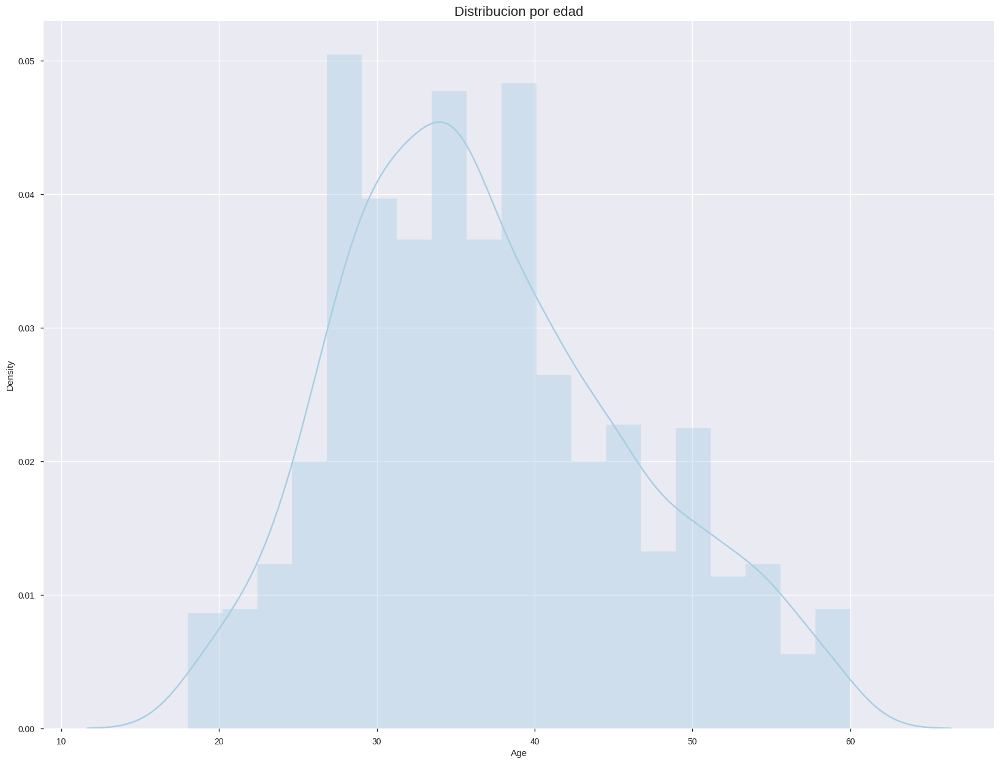

In [ ]:
sns.distplot(df_hr["Age"])
plt.title('Distribucion por edad', fontsize = 16)

###**Ingreso Mensual**

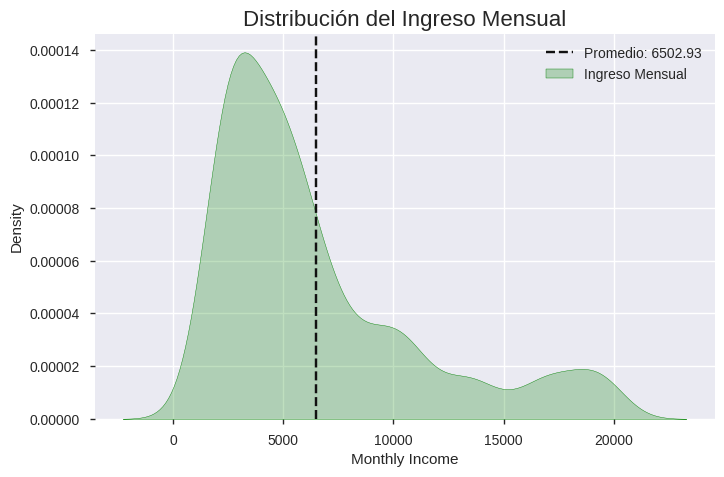

In [ ]:
plt.figure(figsize=(8,5), edgecolor='green')
sns.kdeplot(x=df_hr['MonthlyIncome'],color='Green',shade=True,label='Ingreso Mensual')
plt.axvline(x=df_hr['MonthlyIncome'].mean(),color='k',linestyle ="--",label='Promedio: 6502.93')
plt.xlabel('Monthly Income')
plt.legend()
plt.title('Distribución del Ingreso Mensual', fontsize = 16)
plt.show()

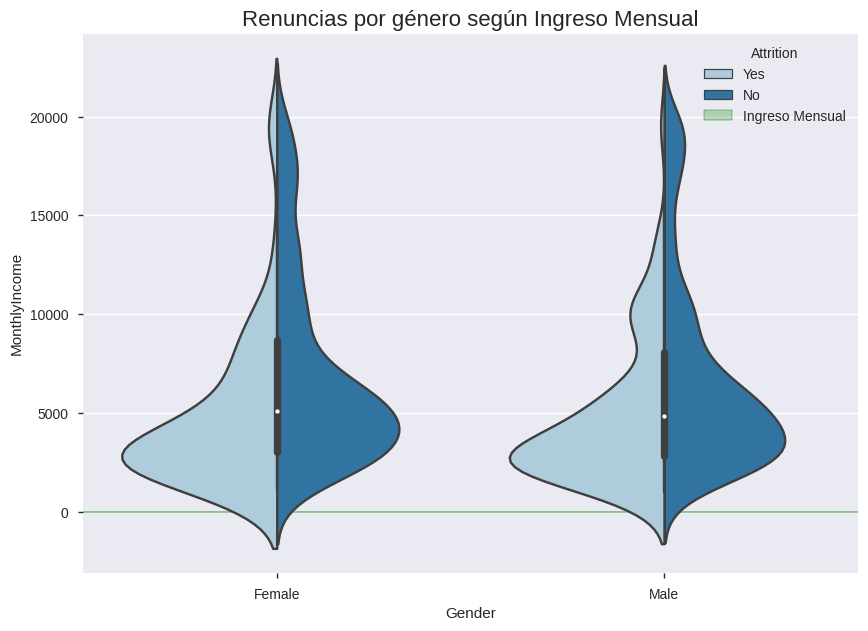

In [ ]:
fig,ax = plt.subplots(figsize=(10,7))
sns.kdeplot(x=df_hr['MonthlyIncome'],color='Green',shade=True,label='Ingreso Mensual')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias por género según Ingreso Mensual', fontsize = 16)
sns.violinplot(x='Gender', y='MonthlyIncome',hue='Attrition',split=True,data=df_hr)

###**Nivel educativo**

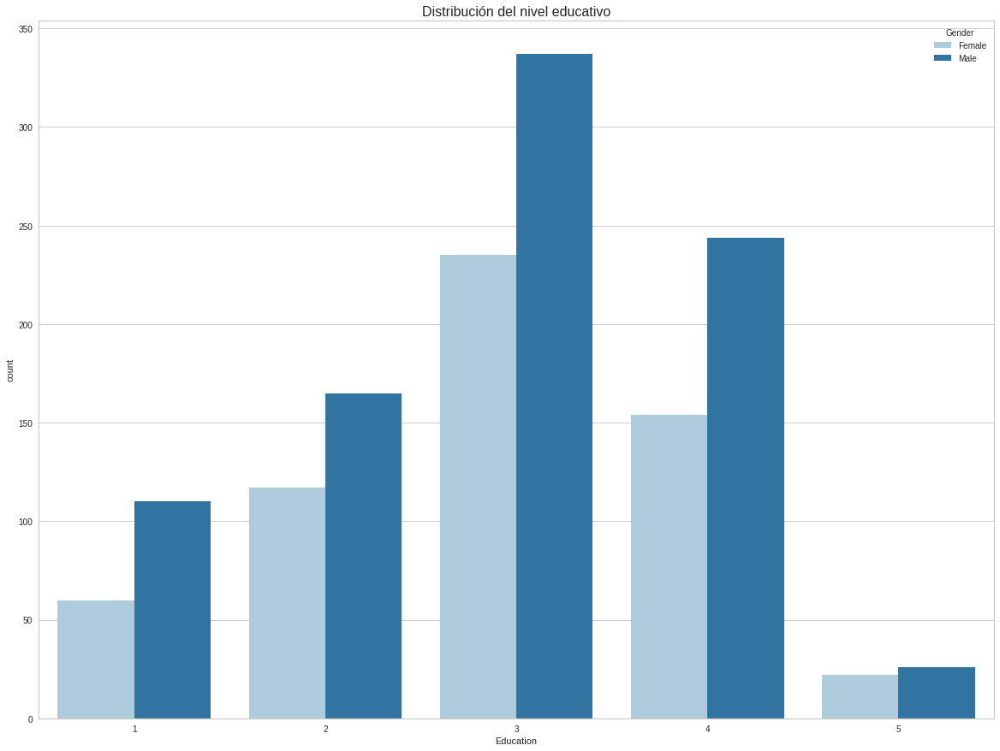

In [ ]:
sns.countplot(data=df_hr, x='Education', hue='Gender')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Distribución del nivel educativo', fontsize = 16)
plt.show()

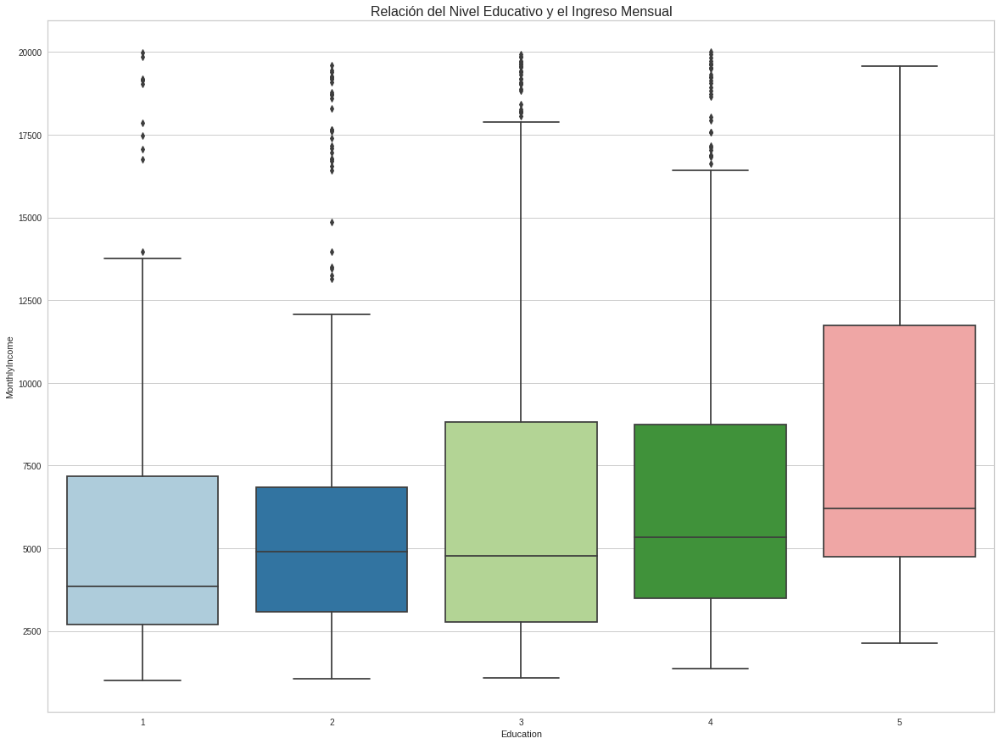

In [ ]:
sns.boxplot(data=df_hr, x='Education', y='MonthlyIncome')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Relación del Nivel Educativo y el Ingreso Mensual', fontsize = 16)
plt.show()

###**Estado de satisfacción del empleado**

In [ ]:
fig=go.Figure()
fig=make_subplots(rows=1,cols=2)
fig = make_subplots(rows=1, cols=3, specs=[[{"type": "pie"}, {"type": "pie"}, {"type": "pie"}]],subplot_titles=('Environment Satisfaction', 'Job Satisfaction','Relationship Satisfaction'))
fig.add_trace(go.Pie(values=df_hr.groupby(['EnvironmentSatisfaction'],as_index=False)['Age'].count()['Age'],labels=df_hr.groupby(['EnvironmentSatisfaction'],as_index=False)['Age'].count()['EnvironmentSatisfaction'],hole=0.7,marker_colors=["#A6CEE3", "#1F78B4", "B2DF8A", "#33A02C", "#FB9A99"],name='Environment Satisfaction',showlegend=False),row=1,col=1)
fig.add_trace(go.Pie(values=df_hr.groupby(['JobSatisfaction'],as_index=False)['Age'].count()['Age'],labels=df_hr.groupby(['JobSatisfaction'],as_index=False)['Age'].count()['JobSatisfaction'],hole=0.7,marker_colors=['#A6CEE3", "#1F78B4", "B2DF8A", "#33A02C", "#FB9A99'] ,name='Environment Satisfaction',showlegend=False),row=1,col=2)
fig.add_trace(go.Pie(values=df_hr.groupby(['RelationshipSatisfaction'],as_index=False)['Age'].count()['Age'],labels=df_hr.groupby(['RelationshipSatisfaction'],as_index=False)['Age'].count()['RelationshipSatisfaction'],hole=0.7,marker_colors=['#A6CEE3", "#1F78B4", "B2DF8A", "#33A02C", "#FB9A99'],name='Relationship Satisfaction',showlegend=True),row=1,col=3)
fig.update_traces(textposition='outside', textinfo='percent')



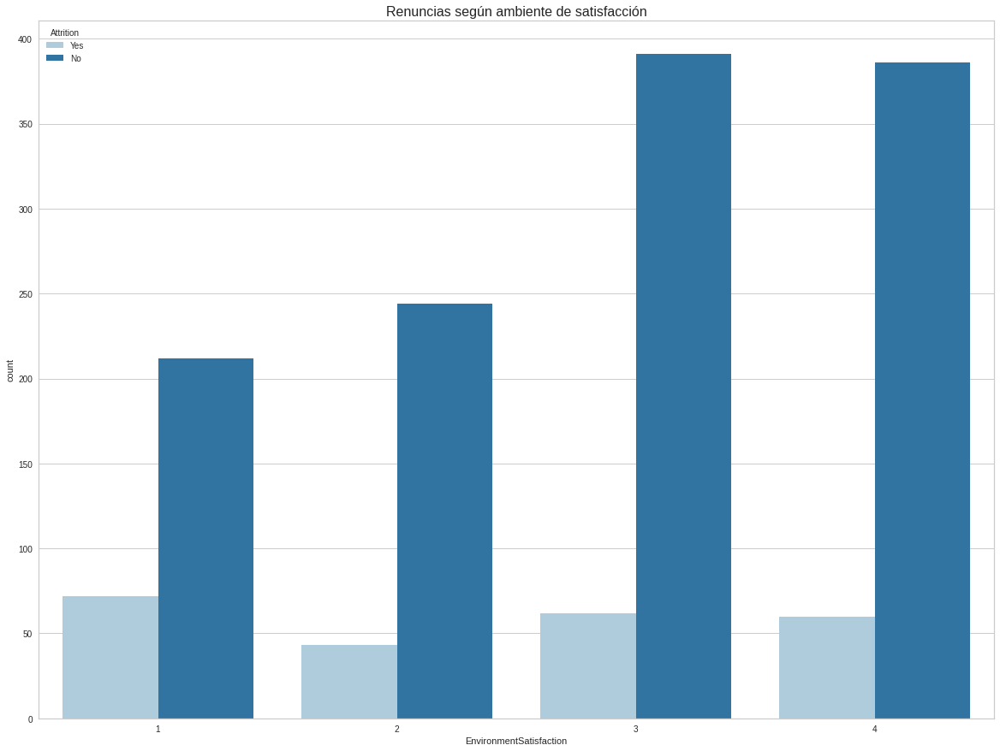

In [ ]:
sns.countplot(data=df_hr, x='EnvironmentSatisfaction', hue='Attrition')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias según ambiente de satisfacción', fontsize = 16)
plt.show()

### **Contexto analítico**
------


Algunas consideraciones a tener en cuenta: 
La primer cuestión a considerar es que estamos trabajando con un **dataset pequeño y desbalanceado** ya que solo el 16% de los empleados han decidido renunciar.

Las variables que se encuentra son de dos tipos: **categóricas y numéricas.**

A primera vista mayor nivel educativo implica mayor salario y por ende, mayor estabilidad laboral. De la misma manera, mayor edad implica mejor salario y mayor tendencia a quedarse en la empresa. Esta situación estaría fuertemente influenciada por la situación familiar/ personal del empleado.

Los hombres suelen dejar sus puestos laborales con más frecuencia que las mujeres, aún en edades más avanzadas. Esta situación podría estar relacionada con el techo de cristal que suele estar presente en los ámbitos laborales en referencia a las mujeres. 

El mayor número de colaboradores cuenta con un nivel educacional de bachiller, para ambos sexos. Esto podría entenderse como un nivel de sociedades avanzadas con buen nivel de escolarización. Por otra parte, el menor número de colaboradores cuenta con un nivel de PhD, lo que sería natural debido a los costos de las matrículas y el balance necesario entre estudio y trabajo.

###**PREGUNTA 1: ¿Qué factores tienen mayor peso en la decisión de renuncia de los colaboradores?** 



En este punto nos enfocaremos inicialmente en tres aspectos centrales de una relación laboral: el salario, el nivel educacional y el área en el que trabaja.

In [ ]:
plot_df= df_hr.sort_values(by="Attrition")
fig=px.histogram(plot_df, x='MonthlyIncome', color='Attrition', 
                 opacity=0.8, histnorm='density', barmode='overlay', marginal='box',
                 color_discrete_map={'Yes': '#4374B3','No': '#3CAEA3'})
fig.update_layout(title_text='Renuncias segun ingreso mensual',
                  xaxis_title='Ingreso mensual, $', yaxis_title='Densidad',font_color='#28221D',
                  paper_bgcolor='#F4F2F0', plot_bgcolor='#F4F2F0', legend_traceorder='reversed')
fig.show()

***Análisis***: Como se ve en el gráfico, la tasa de deserción es evidentemente más alta en niveles de ingresos muy bajos, menores de 5k mensuales. Esta situación disminuye a medida que el salario crece, especialmente tras pasar la barrera de los 10k, generalmente asociado al nivel de vida de la clase media. Cuando el ingreso mensual alcanza el nivel de clase media, las posibilidades de que un empleado abandone la organización decrecen, como se ve en la línea plana.


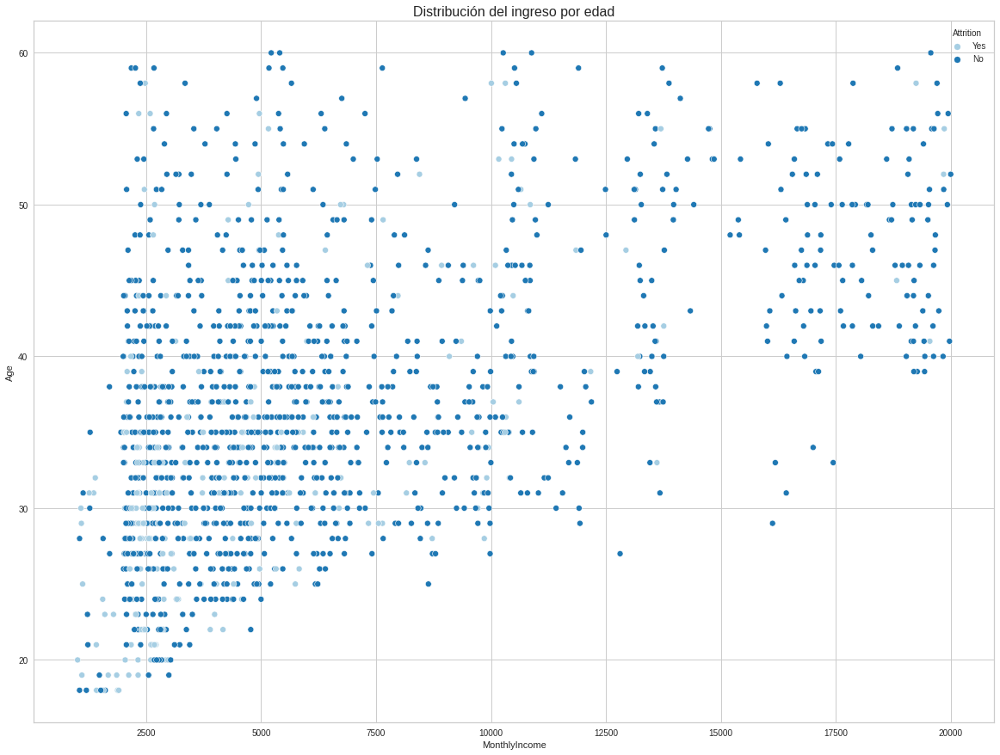

In [ ]:
sns.scatterplot(data=df_hr, x='MonthlyIncome', y='Age', hue='Attrition')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Distribución del ingreso por edad', fontsize = 16)
plt.show()

***Análisis***:Las renuncias se presentan con mayor frecuencia entre el personal joven que tiene un ingreso menor a 5K. Puede observarse además que los rangos salariales más altos comienzan a percibirse hacia la edad de 40 años, cuando la mayor parte de las personas necesitan mantener a otra persona además de a sí mismo. Estos factores (mayores ingresos y una familia que mantener) contribuirían a la estabilidad laboral.  

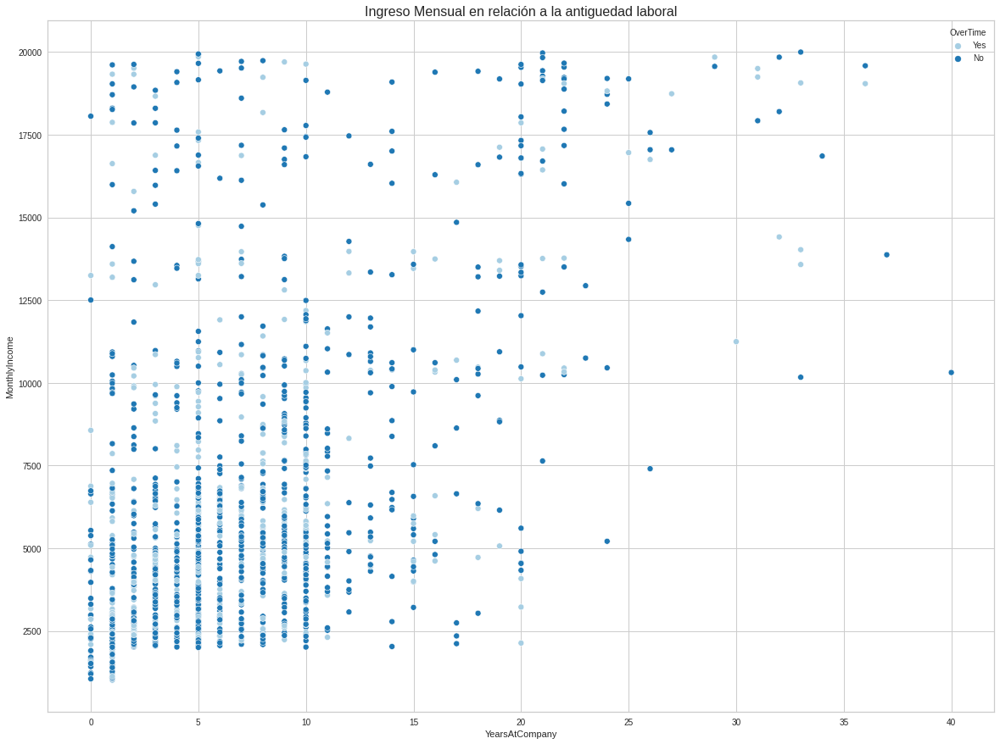

In [ ]:
sns.scatterplot(data=df_hr, x='YearsAtCompany', y='MonthlyIncome', hue='OverTime')
sns.set_palette(sns.color_palette("Paired"))

plt.title('Ingreso Mensual en relación a la antiguedad laboral', fontsize = 16)
plt.show()

***Análisis***: La baja cantidad de horas extras indicaría que el personal no tendría necesidad de complementar su sueldo básico, lo que podría implicar que las razones para dejar el puesto laboral no estarían completamente vinculadas al salario.



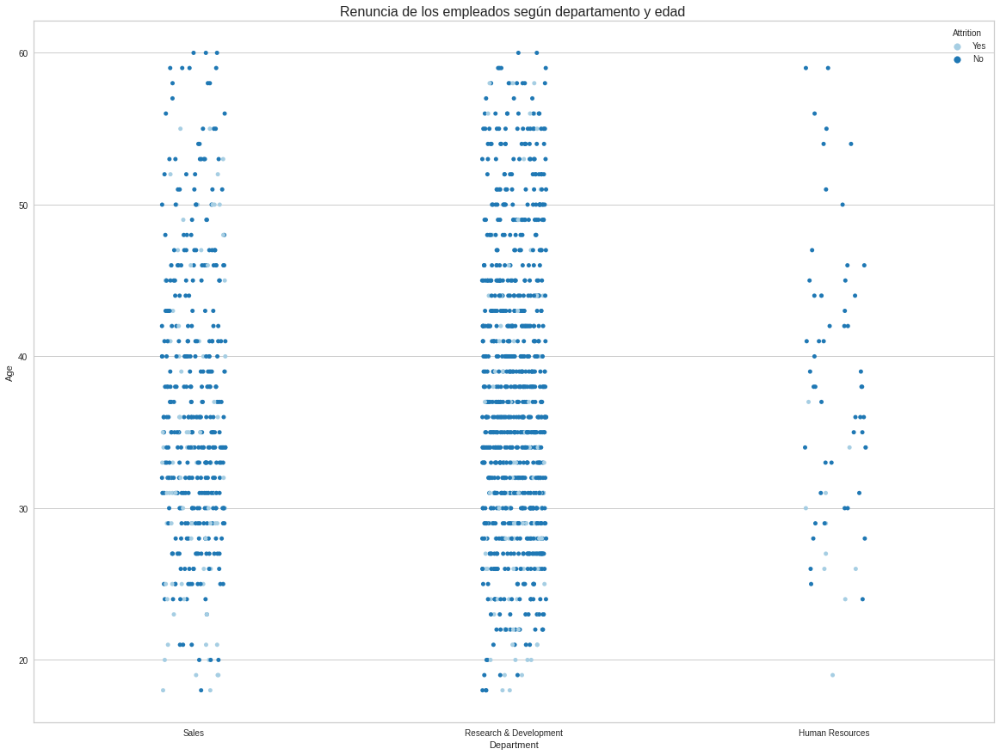

In [ ]:
sns.stripplot(data=df_hr, x='Department', y='Age', hue='Attrition')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncia de los empleados según departamento y edad ', fontsize = 16)
plt.show()

***Análisis***: se evidencia que no existe un mayor nivel de renuncias por rol ejercido. Estos podría indicar, a priori que no existiría mayor rotación de personal en áreas como Investigación y Desarrollo el cual se encuentra en alta demanda en el mercado actual y suele competir por remuneración.


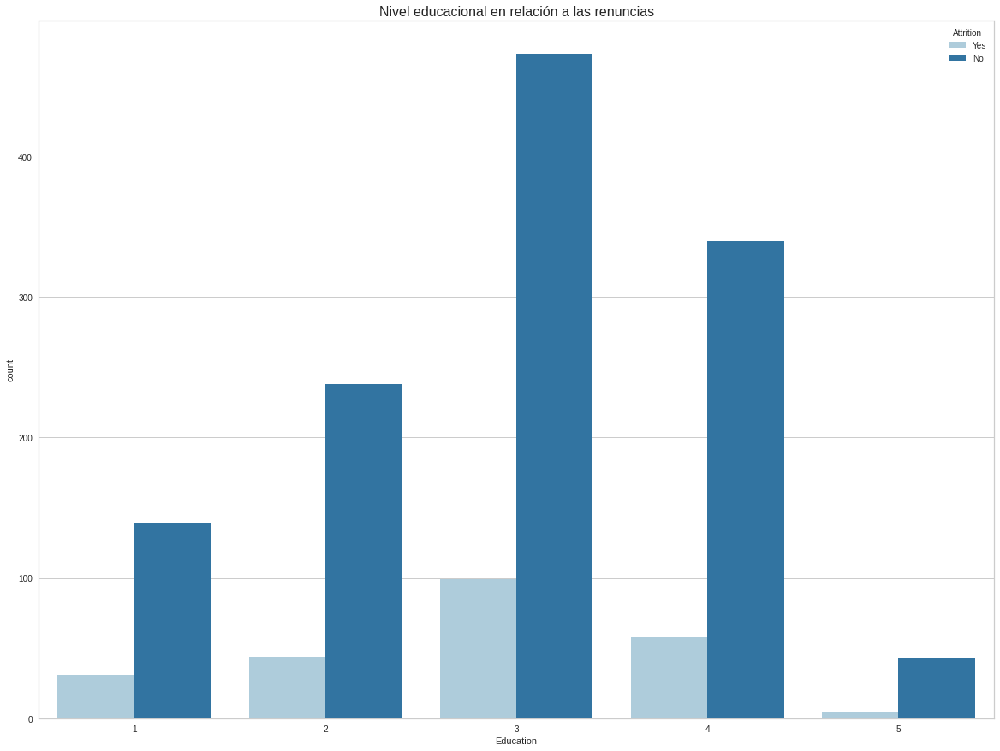

In [ ]:
sns.countplot(data=df_hr, x='Education', hue='Attrition')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Nivel educacional en relación a las renuncias', fontsize = 16)
plt.show()

Education
1 'Below College'
2 'College'
3 'Bachelor'
4 'Master'
5 'Doctor'

***Análisis***: los resultados de este gráfico indican que la mayor cantidad de renuncias se presentan a nivel de título de grado. Esto posiblemente esté relacionado a la movilidad laboral por edad, por lo que será interesante valorar los tres aspectos a la vez.

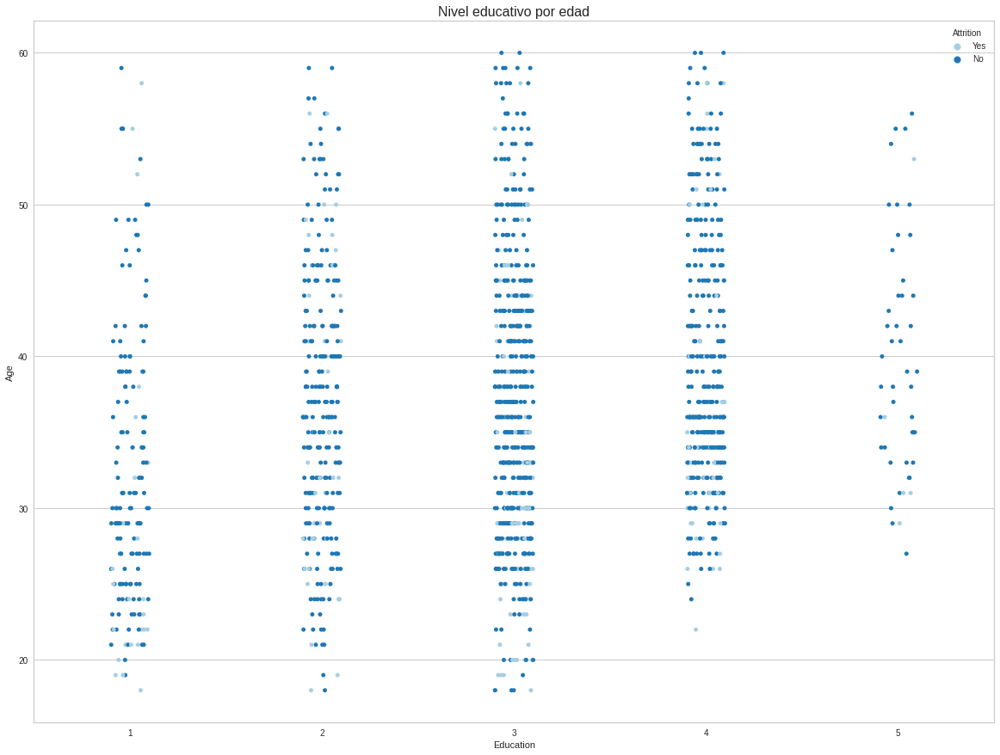

In [ ]:
sns.stripplot(data=df_hr, x='Education', y='Age', hue='Attrition')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Nivel educativo por edad', fontsize = 16)
plt.show()

***Análisis***: la mayor cantidad de renuncias se presentan a edad temprana (antes de los 35 años) y en la categoría título de grado. Sin embargo, debe considerarse que la mayor cantidad de empleados posee un título a nivel de licenciatura, por lo que se deberá trabajar con porcentajes por categorías para que podamos realizar mejores conclusiones.

###*INSIGHTS PREGUNTA 1*
Hasta el momento, de los 3 factores analizados no puede concluirse que uno posea mayor relevancia a la hora de tomar la decisión de dejar un puesto laboral. Es muy probable que al momento de renunciar los motivos sean multicausales, balancenado estos tres factores. 

Debe continuar trabajandose sobre la pregunta.




### **PREGUNTA 2: ¿Los trabajadores con menor edad presentan mayores renuncias?**


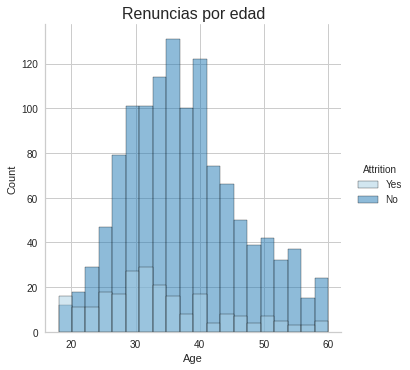

In [ ]:
sns.displot(data=df_hr, hue='Attrition', x='Age', bins=20)
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias por edad', fontsize = 16)
plt.show()

*Análisis*: las mayores renuncias se presentan en colaboradores de edad entre 28 y 35 años.
La hipótesis ha sido verificada, ya que las menores renuncias se presentan en grupos etarios menores y mayores al rango presentado.

### **PREGUNTA 3: ¿Existen diferencias en los niveles de satisfacción laboral según el área en la empresa?**



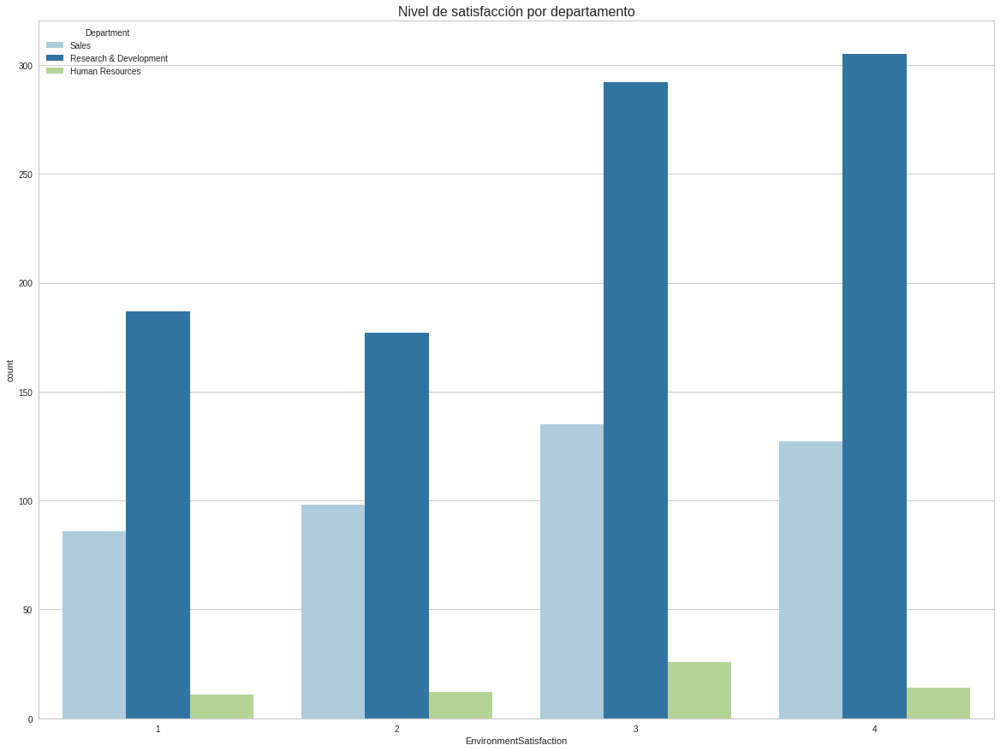

In [ ]:
sns.countplot(data=df_hr, x='EnvironmentSatisfaction', hue='Department')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Nivel de satisfacción por departamento', fontsize = 16)
plt.show()

Análisis: se evidencia mayor nivel de satisfacción laboral en el área de investigación y desarrollo. En cuanto a las áreas de ventas y de recursos humanos, se presencia que los colaboradores expresan un nivel de satisfacción laboral favorable (nivel 3)

# **Otros insights**

Los análisis realizados no nos permitirían concluir respecto de los aspectos fundamentales de este trabajo: el mayor peso de las categorías ante la decisión de dejar un puesto laboral y, por otro lado, predecir qué trabajadores podrían dejar su trabajo. Es por ello que continuaremos los procesos de análisis.



## **TRABAJO DE VARIABLES**
----

In [ ]:
discrete_features = ['Age', 'DailyRate', 'DistanceFromHome', 'HourlyRate', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
                 'PercentSalaryHike', 'StandardHours', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany', 
                 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']
categorical_features = ['Attrition', 'BusinessTravel','Department', 'Education', 'EducationField', 'EmployeeCount','EmployeeNumber',
                    'EnvironmentSatisfaction', 'Gender', 'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
                    'MaritalStatus', 'Over18', 'OverTime', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel',
                    'WorkLifeBalance']

df1 = df_hr.copy(deep = True)

In [ ]:
le = LabelEncoder()
l1 = []; l2 = []; text_categorical_features = []
print('Label Encoder Transformation')
for i in tqdm(categorical_features):
    if type(df1[i][0]) == str:
        text_categorical_features.append(i)
        df1[i] = le.fit_transform(df1[i])
        l1.append(list(df1[i].unique())); l2.append(list(le.inverse_transform(df1[i].unique())))
        print(i,' : ',df1[i].unique(),' = ',le.inverse_transform(df1[i].unique()))

Label Encoder Transformation


100%|██████████| 20/20 [00:00<00:00, 800.13it/s]

Attrition  :  [1 0]  =  ['Yes' 'No']
BusinessTravel  :  [2 1 0]  =  ['Travel_Rarely' 'Travel_Frequently' 'Non-Travel']
Department  :  [2 1 0]  =  ['Sales' 'Research & Development' 'Human Resources']
EducationField  :  [1 4 3 2 5 0]  =  ['Life Sciences' 'Other' 'Medical' 'Marketing' 'Technical Degree'
 'Human Resources']
Gender  :  [0 1]  =  ['Female' 'Male']
JobRole  :  [7 6 2 4 0 3 8 5 1]  =  ['Sales Executive' 'Research Scientist' 'Laboratory Technician'
 'Manufacturing Director' 'Healthcare Representative' 'Manager'
 'Sales Representative' 'Research Director' 'Human Resources']
MaritalStatus  :  [2 1 0]  =  ['Single' 'Married' 'Divorced']
Over18  :  [0]  =  ['Y']
OverTime  :  [1 0]  =  ['Yes' 'No']


In [ ]:
tf1 = {}
for i in range(len(text_categorical_features)):
    tf1[text_categorical_features[i]] = {}
    for j,k in zip(l1[i],l2[i]):
        tf1[text_categorical_features[i]][j] = k

In [ ]:
df1.drop(columns = ['EmployeeCount','Over18'], inplace = True)
categorical_features.remove('EmployeeCount'); categorical_features.remove('Over18')

In [ ]:
df1.drop(columns = ['StandardHours'], inplace = True)
discrete_features.remove('StandardHours')

##**DIVISION Y MODELADO DE LOS DATOS**
----

In [ ]:
class conf:
    index = 'id'
    target = 'Attrition'
    random = 2023
    
    load_original = True
np.random.seed(conf.random)

In [ ]:
cols = list(df1.columns)
cols.remove('Attrition')

over = SMOTE(sampling_strategy = 0.85)
under = RandomUnderSampler(sampling_strategy = 0.1)
f1 = df1.loc[:,cols]
t1 = df1.loc[:,'Attrition']

steps = [('over', over)]
pipeline = Pipeline(steps=steps)
f1, t1 = pipeline.fit_resample(f1, t1)
Counter(t1)

Counter({1: 1048, 0: 1233})

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(f1, t1, test_size = 0.15, random_state = 2)

In [ ]:
x_train_test = x_train.copy(deep = True)
x_train_test['Attrition'] = y_train

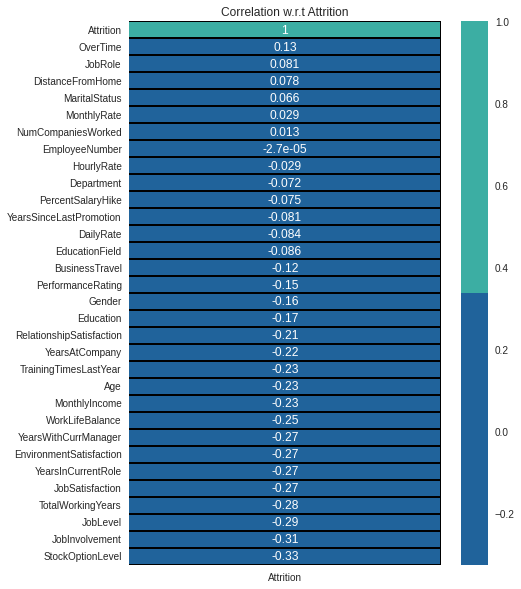

In [ ]:
corr = x_train_test.corrwith(x_train_test['Attrition']).sort_values(ascending = False).to_frame()
colors = ['#20639B','#3CAEA3']
corr.columns = ['Attrition']
plt.subplots(figsize = (7,10))
sns.heatmap(corr,annot = True,cmap = colors, linewidths = 0.4,linecolor = 'black');
plt.title('Correlation w.r.t Attrition');

In [ ]:
tr_clf = ColumnTransformer([
    ("num", SimpleImputer(), discrete_features),
    ("cat", OneHotEncoder(handle_unknown='ignore'), categorical_features),
])
tr_reg = ColumnTransformer([
    ("num", StandardScaler(), discrete_features),
    ("cat", OneHotEncoder(handle_unknown='ignore'), categorical_features),
])

print("train shape = ", x_train.shape)

train shape =  (1938, 31)


In [ ]:
logs = {}
def cross_val_auc(name, pipeline, x=x_train, y=y_train, regressor=False, use_reg=False):
    if regressor:
        x = tr_reg.fit_transform(x)
        p = cross_val_predict(pipeline, x, y, cv=10, n_jobs=5, verbose=False)
    else:
        if use_reg:
            x = tr_reg.fit_transform(x)
        else:
            x = tr_clf.fit_transform(x)
        p = cross_val_predict(pipeline, x, y, cv=10, n_jobs=5, method="predict_proba", verbose=False)[:, 1]
    auc = roc_auc_score(y, p)
    logs[name] = auc
    print(f"auc = {auc:.4f}")

##**ENTRENAMIENTO**
-----

In [ ]:
def classification_all_features(Model):

    model = Model
    
    model.fit(x_train, y_train)
    
    y_pred = model.predict(x_test)
    
    global score
    score = recall_score(y_test, y_pred)
    
    print("Recall score: {}".format(score))
    
    print(classification_report(y_test, y_pred))

In [ ]:
def classification_tuning_all(regularizator):

    model_cv = regularizator
    
    model_cv.fit(x_train, y_train)
    
    y_pred = model_cv.predict(x_test)

    global score 
    score = model_cv.score(x_test, y_test)

    print("Recall score: {}".format(score))

    print("Tuned Model Parameters: {}".format(model_cv.best_params_))
   
    print(classification_report(y_test, y_pred))

#### **Regresión Logística**

In [ ]:
classification_all_features(LogisticRegression(random_state = 0))

Recall score: 0.61875
              precision    recall  f1-score   support

           0       0.68      0.69      0.68       183
           1       0.64      0.62      0.63       160

    accuracy                           0.66       343
   macro avg       0.66      0.66      0.66       343
weighted avg       0.66      0.66      0.66       343



In [ ]:
lrg1 = score

In [ ]:
param_grid = {'C': np.arange(1, 10),
              'class_weight': ['none','balanced'], 
              'penalty': ['l1','l2']}

#Función para el ajuste de hiperparámetros a la regresión logística con todas las features
classification_tuning_all(GridSearchCV(LogisticRegression(random_state=0),
                                       param_grid, cv=5, scoring = 'recall'))

Recall score: 0.7125
Tuned Model Parameters: {'C': 9, 'class_weight': 'balanced', 'penalty': 'l2'}
              precision    recall  f1-score   support

           0       0.71      0.60      0.65       183
           1       0.61      0.71      0.66       160

    accuracy                           0.65       343
   macro avg       0.66      0.66      0.65       343
weighted avg       0.66      0.65      0.65       343



In [ ]:
lrg2 = score

####**Decision Tree Classification**

In [ ]:
classification_all_features(DecisionTreeClassifier(criterion = 'gini', random_state = 0))

Recall score: 0.8125
              precision    recall  f1-score   support

           0       0.83      0.78      0.80       183
           1       0.76      0.81      0.79       160

    accuracy                           0.80       343
   macro avg       0.80      0.80      0.80       343
weighted avg       0.80      0.80      0.80       343



In [ ]:
dt1 = score

In [ ]:
param_dist = {'max_depth': np.arange(2, 30),
              'min_samples_leaf': np.arange(1, 100),
              'criterion': ['gini', 'entropy'],
                'class_weight': ['none','balanced']}

classification_tuning_all(RandomizedSearchCV(DecisionTreeClassifier(random_state = 0), 
                                             param_dist, cv=5, scoring = 'recall'))

Recall score: 0.7375
Tuned Model Parameters: {'min_samples_leaf': 21, 'max_depth': 6, 'criterion': 'gini', 'class_weight': 'balanced'}
              precision    recall  f1-score   support

           0       0.78      0.83      0.81       183
           1       0.79      0.74      0.76       160

    accuracy                           0.79       343
   macro avg       0.79      0.78      0.79       343
weighted avg       0.79      0.79      0.79       343



In [ ]:
dt2 = score

####**Random Forest Classification**

In [ ]:
classification_all_features(RandomForestClassifier(random_state = 0))

Recall score: 0.9
              precision    recall  f1-score   support

           0       0.91      0.92      0.92       183
           1       0.91      0.90      0.91       160

    accuracy                           0.91       343
   macro avg       0.91      0.91      0.91       343
weighted avg       0.91      0.91      0.91       343



In [ ]:
rfc1 = score

In [ ]:
n_estimators = [10, 100, 1000]
max_features = ['auto', 'sqrt']
max_depth = np.arange(10, 100)
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]
class_weight = ['balanced', 'balanced_subsample', 'none']

random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
              'class_weight': class_weight}

classification_tuning_all(RandomizedSearchCV(estimator = RandomForestClassifier(random_state = 0), 
                                             param_distributions = random_grid, cv = 5, 
                                             verbose=1, n_jobs = -1, scoring = 'recall'))


Fitting 5 folds for each of 10 candidates, totalling 50 fits
Recall score: 0.875
Tuned Model Parameters: {'n_estimators': 1000, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': 86, 'class_weight': 'balanced'}
              precision    recall  f1-score   support

           0       0.90      0.93      0.91       183
           1       0.92      0.88      0.90       160

    accuracy                           0.91       343
   macro avg       0.91      0.90      0.91       343
weighted avg       0.91      0.91      0.91       343



In [ ]:
rfc2 = score

####**Gradient Boosting Classification**

In [ ]:
classification_all_features(GradientBoostingClassifier())

Recall score: 0.8625
              precision    recall  f1-score   support

           0       0.88      0.90      0.89       183
           1       0.88      0.86      0.87       160

    accuracy                           0.88       343
   macro avg       0.88      0.88      0.88       343
weighted avg       0.88      0.88      0.88       343



In [ ]:
gbc1 = score

In [ ]:
gb_params = {'n_estimators': [10, 50, 100],
    'learning_rate' : [0.01, 0.1, 1],
    'max_depth': [5, 10, 20],
    'min_samples_leaf': [2, 5, 10]}

classification_tuning_all(RandomizedSearchCV(estimator = GradientBoostingClassifier(random_state = 0),
                                    param_distributions = gb_params, cv = 5, 
                                    verbose=1, n_jobs = -1, scoring = 'recall'))

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Recall score: 0.9125
Tuned Model Parameters: {'n_estimators': 100, 'min_samples_leaf': 5, 'max_depth': 10, 'learning_rate': 1}
              precision    recall  f1-score   support

           0       0.92      0.94      0.93       183
           1       0.93      0.91      0.92       160

    accuracy                           0.93       343
   macro avg       0.93      0.93      0.93       343
weighted avg       0.93      0.93      0.93       343



In [ ]:
gbc2 = score

####**ADA Boost Classification**

In [ ]:
classification_all_features(AdaBoostClassifier())

Recall score: 0.8
              precision    recall  f1-score   support

           0       0.83      0.87      0.85       183
           1       0.84      0.80      0.82       160

    accuracy                           0.84       343
   macro avg       0.84      0.83      0.84       343
weighted avg       0.84      0.84      0.84       343



In [ ]:
abc1 = score

In [ ]:
ab_params = {'n_estimators': [10, 50, 100],
    'learning_rate' : [0.01, 0.1, 1]}

classification_tuning_all(GridSearchCV(estimator = AdaBoostClassifier(random_state = 0),
                                    param_grid = ab_params, cv = 5, 
                                    verbose=1, n_jobs = -1, scoring = 'recall'))

Fitting 5 folds for each of 9 candidates, totalling 45 fits
Recall score: 0.8625
Tuned Model Parameters: {'learning_rate': 1, 'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.88      0.89      0.88       183
           1       0.87      0.86      0.87       160

    accuracy                           0.87       343
   macro avg       0.87      0.87      0.87       343
weighted avg       0.87      0.87      0.87       343



In [ ]:
abc2 = score

####**Comparación de modelos**


In [ ]:
results={'Logistic Regression': [lrg1, lrg2], 
         'Decision Tree': [dt1, dt2], 
         'Random Forest': [rfc1, rfc2], 
         'Gradient Boosting': [gbc1, gbc2], 
         'ADA Boosting': [abc1, abc2]}

In [ ]:
comparison = pd.DataFrame.from_dict(results, orient='index')
comparison.columns = ['all_features', 'tuned_all_features']

In [ ]:
comparison

,all_features,tuned_all_features
Logistic Regression,0.61875,0.7125
Decision Tree,0.81250,0.7375
Random Forest,0.90000,0.8750
Gradient Boosting,0.86250,0.9125
ADA Boosting,0.80000,0.8625


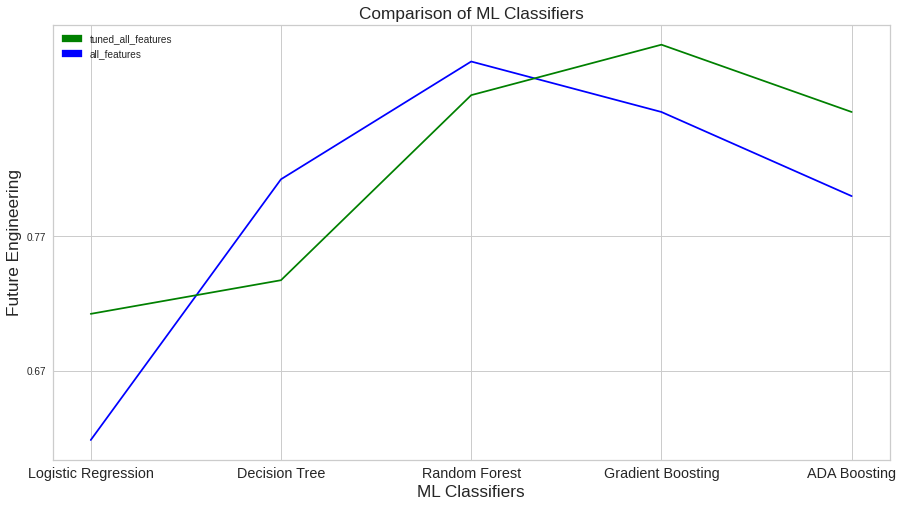

In [ ]:
import matplotlib.patches as mpatches

r = [0,1,2,3,4]

A = comparison.iloc[:,0]
B = comparison.iloc[:,1]

barWidth = 0.85
names = ('Logistic Regression', 'Decision Tree', 'Random Forest', 
         'Gradient Boosting', 'ADA Boosting')
fig = plt.figure(figsize=(15,8))
plt.plot(r, A, color='blue')
plt.plot(r, B, color='green')

plt.xticks(r, names, fontsize='large')
plt.yticks(np.arange(0.67,0.78,0.1))
plt.xlabel("ML Classifiers", fontsize='x-large')
plt.ylabel("Future Engineering", fontsize='x-large')
plt.title("Comparison of ML Classifiers", fontsize='x-large')

green = mpatches.Patch(color='green', label='tuned_all_features')
blue = mpatches.Patch(color='blue', label='all_features')
plt.legend(handles=[green, blue], loc=2)

plt.show()


De los informes de clasificación sobre los datos del tren y de las pruebas, los parámetros de evaluación tienen los mejores valores en el caso del clasificador Gradient Boost.
El punto clave a tener en cuenta es que el parámetro Recall es un parámetro esencial para juzgar el modelo (Tener una alta precisión no es suficiente). Esta característica también tiene un alto valor en nuestro caso.

####**Importancia de las variables en el trabajo del modelo**

In [ ]:
svr = SVC(C = 0.001, class_weight = 'balanced', gamma = 'scale', kernel = 'linear')
clf = svr.fit(x_train, y_train)

clfc = clf.coef_

In [ ]:
value = reduce(lambda x, y: x+y, clfc)
values = [x for x in value]
values

[-0.023899505059987336,
 -0.05732822958221038,
 -0.00027363402113111945,
 -0.03173872555277167,
 0.023357250201570853,
 -0.08745444618701961,
 -0.044510022535243096,
 -3.669417509666317e-05,
 -0.19614113517867818,
 -0.06469939432596947,
 -0.0023131429996659514,
 -0.18453854856686758,
 -0.07012704162520866,
 0.046266515975070956,
 -0.21136019717080634,
 -0.009023508375959798,
 -1.644812908452309e-05,
 3.7512641881676245e-06,
 0.05545514799148238,
 0.09624759284162869,
 -0.038131179464329146,
 -0.03235502566716178,
 -0.1536265268306885,
 -0.22183322807029165,
 -0.035236464689113636,
 -0.18321584638531468,
 -0.17548803404712804,
 0.021283718283275802,
 -0.08043009025606424,
 0.08762806827215526,
 -0.06013607255074092]

In [ ]:
df2 = df1.drop('Attrition', axis =1)

In [ ]:
idx = df2.columns
keys = [str(x) for x in idx.tolist()]
pairs = {keys[i]: values[i] for i in range(len(keys))}

In [ ]:
pairs

{'Age': -0.023899505059987336,
 'BusinessTravel': -0.05732822958221038,
 'DailyRate': -0.00027363402113111945,
 'Department': -0.03173872555277167,
 'DistanceFromHome': 0.023357250201570853,
 'Education': -0.08745444618701961,
 'EducationField': -0.044510022535243096,
 'EmployeeNumber': -3.669417509666317e-05,
 'EnvironmentSatisfaction': -0.19614113517867818,
 'Gender': -0.06469939432596947,
 'HourlyRate': -0.0023131429996659514,
 'JobInvolvement': -0.18453854856686758,
 'JobLevel': -0.07012704162520866,
 'JobRole': 0.046266515975070956,
 'JobSatisfaction': -0.21136019717080634,
 'MaritalStatus': -0.009023508375959798,
 'MonthlyIncome': -1.644812908452309e-05,
 'MonthlyRate': 3.7512641881676245e-06,
 'NumCompaniesWorked': 0.05545514799148238,
 'OverTime': 0.09624759284162869,
 'PercentSalaryHike': -0.038131179464329146,
 'PerformanceRating': -0.03235502566716178,
 'RelationshipSatisfaction': -0.1536265268306885,
 'StockOptionLevel': -0.22183322807029165,
 'TotalWorkingYears': -0.035236

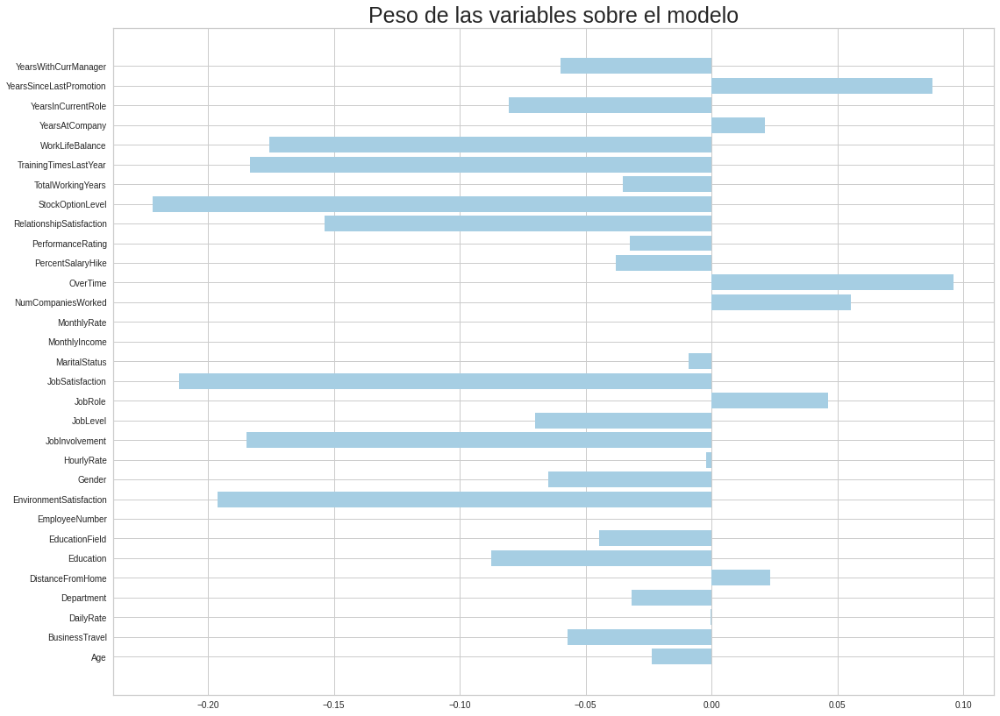

In [ ]:
names = list(pairs.keys())
values = list(pairs.values())

plt.figure(figsize=(18,14))
plt.barh(range(len(pairs)), values, tick_label = names, color = '#A6CEE3')
plt.title('Peso de las variables sobre el modelo', fontsize = 25)
plt.show()

Como podemos observar el SVM ha detectado que las variables YearsSinceLastPromotion y OverTime son las que más peso específico tendrían en el desgaste de los empleados. Ambas poseen coeficientes positivos, lo que significa que la deserción aumentará a medida que aumenten las horas extraordinarias y que no se refleje un cambio de rol o remuneración en el tiempo.

Siguiendo los criterios que pueden deducirse del gráfico, aquellas variables que se observan la sección derecha del gráfico, son las que poseen coeficientes positivos que aumentan la decisión de abandonar la empresa. Además de horas extras y el tiempo transcurrido desde la última promoción se encuentran: los años trabajaos en la empresa, el número de empresas trabajadas previamente, la distancia al hogar y el status marital.

En el lado izquierdo del gráfico, vemos los coeficientes de las características negativas que disminuyen la deserción en la empresa. Estas características pueden ser evaluadas como elementos de acción preventiva para mantener baja la tasa de deserción en la empresa. 

Es para destacar que las variables relacionadas al salario se presentarían como neutras o muy cercanas al eje. Es podría indicar que la remuneración, si bien es una de las variables claves a considerar, no sería definitoria para dejar un puesto de trabajo.

Tanto los coeficientes positivos como los negativos indicados son los factores más importantes en los que la empresa debe centrarse y tomar las medidas necesarias para reducir la deserción.

##**PREDICCIONES**
-------


In [ ]:
clf1 = GradientBoostingClassifier()
gb_params = {'max_leaf_nodes' : [2, 5, 10], 'max_depth': [4, 5, 6, 7],'min_samples_leaf': [2, 5, 10]}

grilla = GridSearchCV(clf1, gb_params, cv=5, scoring = 'recall', verbose=3)
grilla.fit(x_train, y_train)


Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV 1/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=2;, score=0.826 total time=   0.7s
[CV 2/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=2;, score=0.775 total time=   0.7s
[CV 3/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=2;, score=0.747 total time=   0.5s
[CV 4/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=2;, score=0.802 total time=   0.6s
[CV 5/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=2;, score=0.774 total time=   0.8s
[CV 1/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=5;, score=0.826 total time=   0.7s
[CV 2/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=5;, score=0.775 total time=   0.6s
[CV 3/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=5;, score=0.747 total time=   0.5s
[CV 4/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=5;, score=0.802 total time=   0.6s
[CV 5/5] END max_depth=4, max_leaf_nodes=2, min_samples_leaf=5;, score=0.7

GridSearchCV(cv=5, estimator=GradientBoostingClassifier(),
             param_grid={'max_depth': [4, 5, 6, 7],
                         'max_leaf_nodes': [2, 5, 10],
                         'min_samples_leaf': [2, 5, 10]},
             scoring='recall', verbose=3)

In [ ]:
modelo= grilla.best_estimator_
modelo.fit(x_train, y_train)

GradientBoostingClassifier(max_depth=6, max_leaf_nodes=10, min_samples_leaf=10)

In [ ]:
y_pred_test= modelo.predict (x_test)
y_pred_test


array([1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1,
       1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,
       1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0,
       1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1,
       0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1,
       1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0,
       0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0,

In [ ]:
preds= y_pred_test 

In [ ]:
print(accuracy_score(y_test, preds))

0.8892128279883382


In [ ]:
df2 = pd.concat([pd.DataFrame(x_train), pd.DataFrame(preds)], axis = 1, join = 'inner')

In [ ]:
df2.columns =['Age','BusinessTravel', 'DailyRate','Department', 'DistanceFromHome', 'Education', 'EducationField', 'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender','HourlyRate', 'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'OverTime', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager ', 'Preds']

In [ ]:
df2

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,...,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Preds
260,32,1,1311,1,7,3,1,359,2,1,...,3,0,5,3,1,5,1,0,3,0
199,38,2,1084,1,29,3,5,273,4,1,...,1,1,9,3,1,7,7,1,7,1
256,42,2,269,1,2,3,3,351,4,0,...,3,1,10,4,3,9,6,7,8,1
45,41,2,1360,1,12,3,5,58,2,0,...,4,0,23,0,3,22,15,15,8,1
71,29,2,1328,1,2,3,1,94,3,1,...,4,1,6,3,3,5,4,0,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132,31,2,542,2,20,3,1,175,2,0,...,3,1,4,2,3,2,2,2,2,0
31,44,2,1459,1,10,4,4,40,4,1,...,4,0,9,5,4,4,2,1,3,1
255,25,2,685,1,1,3,1,350,1,0,...,4,2,5,3,3,4,2,1,2,0
51,28,2,1434,1,5,4,5,65,3,1,...,3,0,2,3,2,2,2,2,2,0


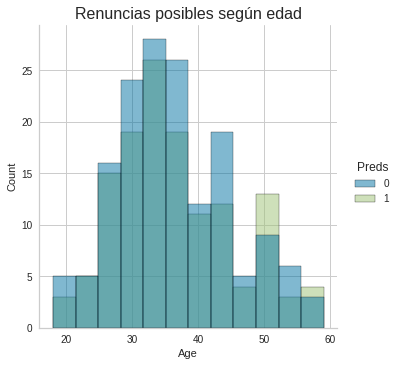

In [ ]:
sns.displot(data=df2, hue='Preds', x='Age')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias posibles según edad', fontsize = 16)
plt.show()

Para comprender mejor segmentamos en grupos la edad de los trabajadores. Creamos 7 grupos: el primero en un rango de 0-18 para entender si hay menores de edad trabajando para la empresa; el segundo hasta los 25 (este sera el unico grupo de 7 años) para agrupar a los jovenes; un tercero hasta los 35; un cuarto hasta los 45, un quinto hasta los 55, un sexto hasta los 65 y finalmente el septimo para comprender si hay personas que continuan trabajando tras la edad jubilatoria estipulada.

In [ ]:
bins = [0, 18, 25, 35, 45, 55, 65, 80]
names= ["1", "2", "3", "4", "5", "6", "7"]
df2["Age"]= pd.cut(df_hr["Age"], bins, labels= names)


In [ ]:
df2[['Age']].value_counts().sort_values(ascending=False).head(10)

Age
3      123
4       99
5       40
2       21
6        7
1        2
7        0
dtype: int64

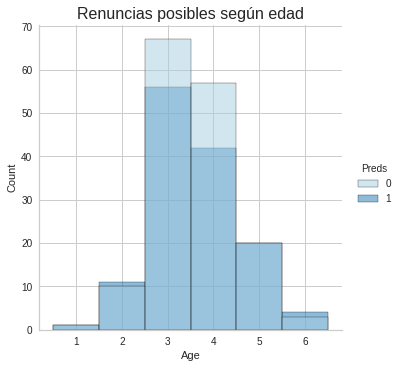

In [ ]:
sns.displot(data=df2, hue='Preds', x='Age', bins=20)
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias posibles según edad', fontsize = 16)
plt.show()

Edad:

1 = 0 a 18; 2 = 18 a 25; 3 = 25 a 35; 4 = 35 a 45; 5= 45 a 55;  6 = 55 a 65;  7= 65 a 80

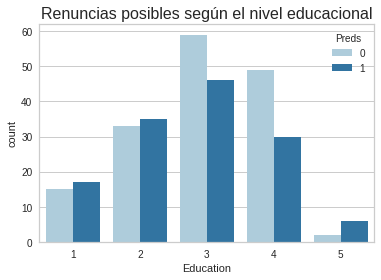

In [ ]:
sns.countplot(data=df2, x='Education', hue='Preds')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias posibles según el nivel educacional', fontsize = 16)
plt.show()

Education
1 'Sin título universitario'
2 'Universitario'
3 'Titulo Universitarior'
4 'Master'
5 'Doctor'

In [ ]:
sns.displot(data=df2, x='Education', y='Age', bins=20)
sns.set_palette(sns.color_palette("Paired"))
plt.title('Relación según edad y nivel educativo', fontsize = 16)
plt.show()

NameError: ignored

Education: 1 'Below College' 2 'College' 3 'Bachelor' 4 'Master' 5 'Doctor'


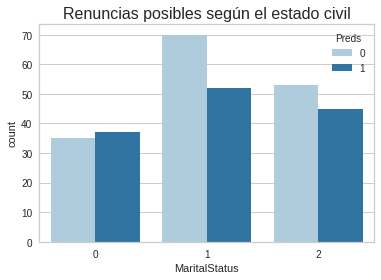

In [ ]:
sns.countplot(data=df2, x='MaritalStatus', hue='Preds')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias posibles según el estado civil', fontsize = 16)
plt.show()

Leyenda> 0= Solteros; 1= Casados; 2= Divorciados

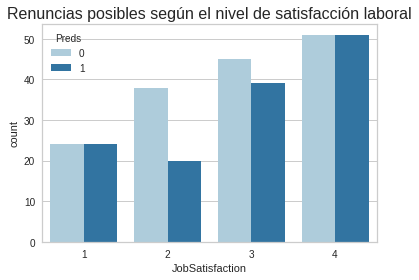

In [ ]:
sns.countplot(data=df2, x='JobSatisfaction', hue='Preds')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias posibles según el nivel de satisfacción laboral', fontsize = 16)
plt.show()

Satisfacción laboral: 1 'Low' 2 'Medium'  3 'High' 4 'Very High'

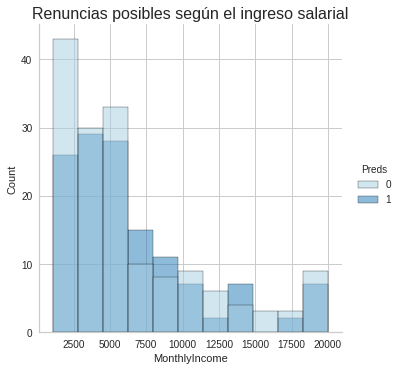

In [ ]:
sns.displot(data=df2, x='MonthlyIncome', hue='Preds')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias posibles según el ingreso salarial', fontsize = 16)
plt.show()

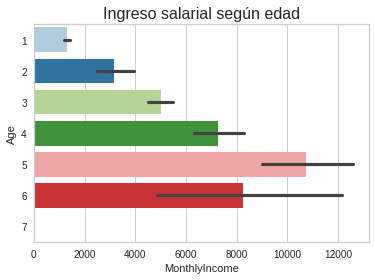

In [ ]:
sns.barplot(data=df2, x='MonthlyIncome', y='Age')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Ingreso salarial según edad', fontsize = 16)
plt.show()

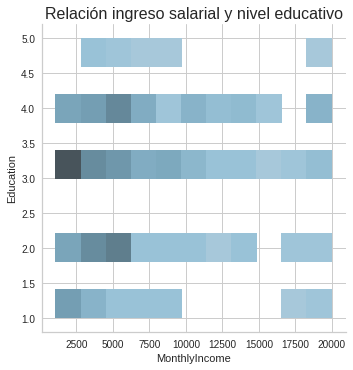

In [ ]:
sns.displot(data=df2, x='MonthlyIncome', y='Education')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Relación ingreso salarial y nivel educativo', fontsize = 16)
plt.show()

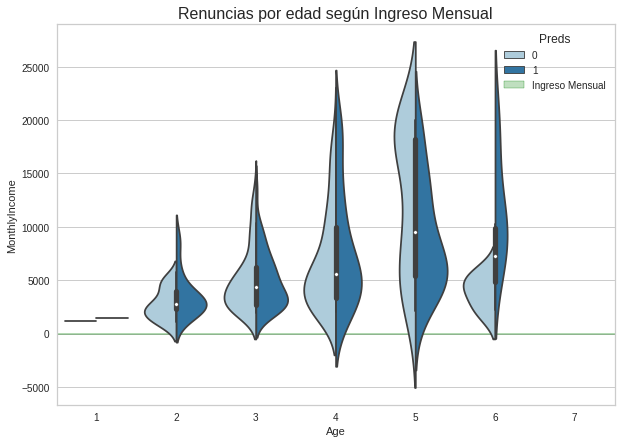

In [ ]:
fig,ax = plt.subplots(figsize=(10,7))
sns.kdeplot(x=df2['MonthlyIncome'],color='Green',shade=True,label='Ingreso Mensual')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias por edad según Ingreso Mensual', fontsize = 16)
sns.violinplot(x='Age', y='MonthlyIncome',hue='Preds',split=True,data=df2)

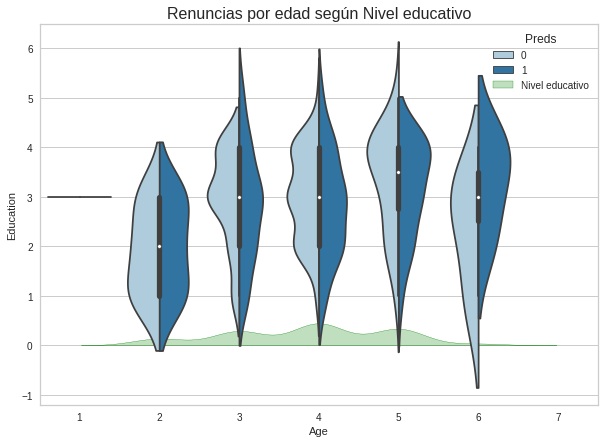

In [ ]:
fig,ax = plt.subplots(figsize=(10,7))
sns.kdeplot(x=df2['Education'],color='Green',shade=True,label='Nivel educativo')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias por edad según Nivel educativo', fontsize = 16)
sns.violinplot(x='Age', y='Education',hue='Preds',split=True,data=df2)

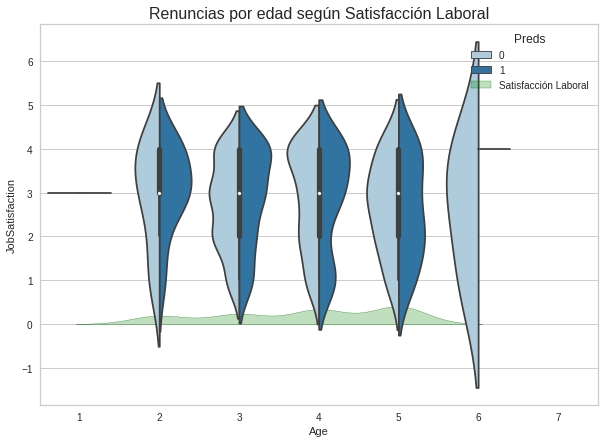

In [ ]:
fig,ax = plt.subplots(figsize=(10,7))
sns.kdeplot(x=df2['JobSatisfaction'],color='Green',shade=True,label='Satisfacción Laboral')
sns.set_palette(sns.color_palette("Paired"))
plt.title('Renuncias por edad según Satisfacción Laboral', fontsize = 16)
sns.violinplot(x='Age', y='JobSatisfaction',hue='Preds',split=True,data=df2)

#**CONCLUSIONES GENERALES DEL TRABAJO**
------------
Para finalizar nuestro análisis debemos realizar una serie de consideraciones:

En primer lugar y en cuanto al dataset en trabajo debe considerarse que si bien el mismo es relevante por pertenecer a la empresa IBM, la cantidad de observaciones (1.470) son insuficientes para crear un algoritmo robusto de aprendizaje automático que permita predecir con certezas el desgaste del empleado y por ende, comprender de antemano quién dejará la empresa. La precisión de las predicciones del modelo estarán vinculadas al ingreso de nueva información, o bien del trabajo en comparativo con otro/s dataset de la misma temática.

La decisión de utilizar modelos de clasificación se debió a que en el desarrollo del proyecto eran los que mejores resultados arrojaban frente a Regressors y de agrupación. Gradient Boost fue finalmente seleccionado para el entrenamiento debido a alcanzar mejores métricas que el resto, inclusive un salto de calidad en cuanto a la hiperparametrización, como puede verse en la gráfica de comparación de modelos. 
Aun cuando obtuvimos un 90% de precisión, el modelo aún puede mejorar. En una futura exploración de modelos podría realizarse una comparación con otros métodos de regresión y agrupación (se estudiaron Linear Regressor y Random Forest Regresor por un lado y K-means por el otro) con el objetivo de continuar explorando métodos que permitan robustecer el modelo. Esta situación podría ser especialmente interesante si se agregan mayores datos, que era uno de los problemas más identificables al intentar realizar agrupamientos, ya que la baja cantidad de renuncias efectivas no nos arrojaban clusters definidos.

Respecto al desarrollo del objetivo del proyecto, el cual fue generar un modelo que permitiera predecir qué colaboradores podrían potencialmente renunciar en la empresa, el objetivo se encuentra cumplido. La segunda parte del objetivo consistía en determinar las variables que mayor peso tienen en la decisión del empleado de dejar su puesto laboral, este objetivo también pudo ser resuelto. Sin embargo, la hipótesis central del estudio fue comprobada solo parcialmente. De las variables propuestas como las más influyentes: **"Edad", "Ingreso Salarial", "Nivel Educacional" y "Nivel de Satisfacción Laboral"**, solo la última tiene un peso decisivo como variable de retención. Por otra parte, el nivel educacional y la edad también se encuentran del lado de la retención aunque significativamente menos relevantes.   

Por otra parte, el trabajo de predicciones arrojó que las variables de **"YearsSinceLastPromotion"** (años desde la última promoción) y **"OverTime"** (horas extras) son las que más peso específico tendrían en el desgaste de los empleados. Ambas poseen coeficientes positivos, lo que significa que la deserción aumentará a medida que aumenten las horas extraordinarias y que no se refleje un cambio de rol o remuneración en el tiempo. Este insight se considera fundamental para el área de Recursos Humanos (RRHH), ya que tal como reflejaba nuestra hipótesis, se pensó en variables mayormente representativas del perfil de colaboradores como influyentes en la decersión.

La mayor sorpresa ante el análisis del peso de las variables fue, sin dudas, el rol que juegan las variables referidas a la remuneración. Estas demostraron tener un impacto casi nulo sobre la decisión de dejar el puesto laboral. Esto podría dar cuenta de que, en primer lugar, los trabajadores encuentran adecuado su salario para el rol desarrollado y, en segundo lugar, que las horas extras realizadas no estarían en relación con una necesidad de mayores ingresos. Esta situación podría ser un alerta para los jefes de área que estarían realizando un manejos erróneo de los tiempos de trabajo, lo que termina en la necesidad de horas extras para finalizar proyectos. 

Una segunda conclusión respecto a la cuestión salarial se refiere al **"StockOption"**. Esta categoría es la que mayor peso tendría sobre los empleados para decidir permanecer en la empresa. Este hecho podría ser de importancia para RRHH ante una negociación para la retención de un empleado.

Otra importante conclusión del estudio del peso de las variables es comprender que aquellas vinculadas al puesto laboral:**"JobInvolvement"** y **"JobSatisfaction"** están entre las variables que contribuyen a que el empleado desee continuar en su puesto laboral, mientras que **JobRole** se encuentra dentro de las variables de desgaste. Esta situación debería ser profundizada por el equipo de RRHH para comprender la real situación de los empleados respecto del nivel de satisfacción en cuanto a sus tareas.

Realicemos ahora algunas conclusiones en base a la información que nos aportaron los gráficos de predicciones:
- En primer lugar debe considerarse que las predicciones indican que la población etaria con mayor desgaste y posibilidad de renuncia se encuentra en el comprendido entre los 23 y 26 años. Además se evidencian dos picos importantes de desgaste a los 30 y 36 años. De hecho, el desgaste comienza a mostrar incrementos significativos cuando los empleados se acercan a la edad de 30 años y se mantiene alto hasta casi los 36 años. El segmento 2 que va de los 25 a 35 años muestra una posibilidad de renuncias más alta que de permanencia. 

- Cuando al análisis anterior agregamos el status civil, observamos que los empleados solteros tienen la tasa de deserción más alta en todos los estamentos. Si consideramos que la mayor parte de los empleados solteros posee menos de 35 años, podríamos concluir que la independencia y la juventud podrían ser dos elementos que lleven a este grupo a pobrar nuevos horizontes. 
Además, sobre este grupo no influirían cuestiones remunerativas o de satisfacción laboral, por ello entemos que este grupo, si bien está motivado por una buena remuneración, quizás esta influya más al momento de cambiar de trabajo que de permanecer en el que ya tiene. Es por ello que este segmento, identificado por las analistas como segmento **TARGET** debería ser el más atendido por la empresa para conocer sus necesidades y crear una estrategia de retención apropiada, especialmente porque muchos de ellos aún se encuentra en la facultad o están recién recibidos de su título de grado. 

- Por otro lado, los casados/divorciados aumentan la probabilidad de renunciar a partir de los 45 años, mostrando un pico en el segmento que va de los 55 a los 65. Este segmento puede estar interpelado por la posibilidad de obtener puestos de gerencia en otras empresas debido a un recorrido previo o bien, a la jubilación.

- Como bien se refleja en el modelo, los empleados que trabajan horas extras tienen muchas más probabilidades de renunciar. Por lo tanto, la empresa debe entender la razón por la que están trabajando horas extras. ¿Se debe a una carga de trabajo demasiado alta o las calificaciones de los empleados no son suficientes para completar las tareas programadas a tiempo? Tal vez podría haber otras razones detrás de esto. Nuestra recomendación será comprender el motivo de las horas extraordinarias con una investigación detallada y tomar las medidas adecuadas para reducir los factores detrás de este factor de deserción.

- Finalmente considerar algunas actividades extras como condicionantes del desgaste como se vio en el análisis de variables: el 18% de los empleados viaja con frecuencia y tiene el mayor porcentaje de deserción (25%). La empresa debe preguntarse qué hace que viajar sea una carga para sus empleados. La empresa debe equilibrar el estado de los viajes y, si es necesario, puede haber algunos ajustes en la descripción del trabajo en términos de viajes. La empresa puede usar algunos incentivos adicionales para motivar a sus empleados que se supone que deben viajar.

Algunas recomendaciones que se pueden realizar a la empresa para continuar la exploración refieren a la incorporación de nueva información respecto de condiciones laborales como la incorporación del trabajo remoto. Asimismo, sería interesante poder agregar fechas como las fechas de incorporación y fechas de renuncia para comprender cómo están vinculadas con el entorno externo a la empresa. 

Este es solo un análisis general que ha sido seleccionado en base a los presupuestos del trabajo. El modelo permite profundizar el mismo y continuar explorando las variables para comprender mejor las razones detrás de las renuncias, lo que podrá realizarse del trabajo conjunto con el departamento de RRHH. 





